Name: __________________ Class: __________________ Date: __________________

<center>
    <img width="100%" src="https://raw.githubusercontent.com/astroDimitrios/AstronomyClass/master/DesignAssets/Ai/Banner3plainCut.png" alt='AP Logo'>
</center>

# Lunar Surface

## AIM - To compare our Moon image to known data and calculate some feature sizes
Difficulty: Hard

<div class="alert alert-block alert-warning">
    <strong>Note</strong> - You need an image of the Moon that you've taken for this activity, preferably with a telescope, which shows the terminus (first or third quarter moons are best). My demo image is in this directory under <strong>mymoon.jpg</strong>.
</div>

**Predict**

Have a think about these questions and make some predictions! Be sure to tell someone else what you predict.

1) Do the near and far sides of the Moon look the same?  
2) What sort of surface features do you think you can find on the Moon?  
3) How do we measure the height of the Moons surface?

**Enter your predictions:**    
1)    
2)    
3)    

## Contents

* [Start](#Start)
* [Crater Width](#CWID)
* [Crater Depth](#CDEP)
* [LRO and LOLA Data](#LRO)
* [Challenges](#Challenges)
* [References](#References)
* [Acknowledgements](#ACK)

## Let's go: <a class="anchor" id="Start"></a>

Import the required modules below:

In [1]:
# run me
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from IPython.display import Image
from skyfield.api import PlanetaryConstants, load
from scipy import ndimage
from skimage import io
%matplotlib widget

In this notebook you will first compare your image of the Moon with a map from the Lunar and Planetary Institute (LPI). 

<div class="alert alert-block alert-success">
    Upload your image by clicking on <strong>File - Open</strong> which opens the dashboard view then the <strong>upload</strong> button on the top right. Rename it to <strong>mymoon.jpg</strong> (or png) and load it below:</div>

In [2]:
moon = io.imread('mymoon.jpg')

A telescope will flip the image upside down so now rotate the image so the Moon is how you saw it with yours eyes in the sky.

If you took the image with your phone then it may not need rotating.

<div class="alert alert-block alert-success">
    Use the next cell to rotate your image and then run the cell after to plot your image.
</div>

In [3]:
# Your image will need rotating since the telescope flips the image
# you might have to change this angle from 225 degrees!
moon_rot = ndimage.rotate(moon, 225)

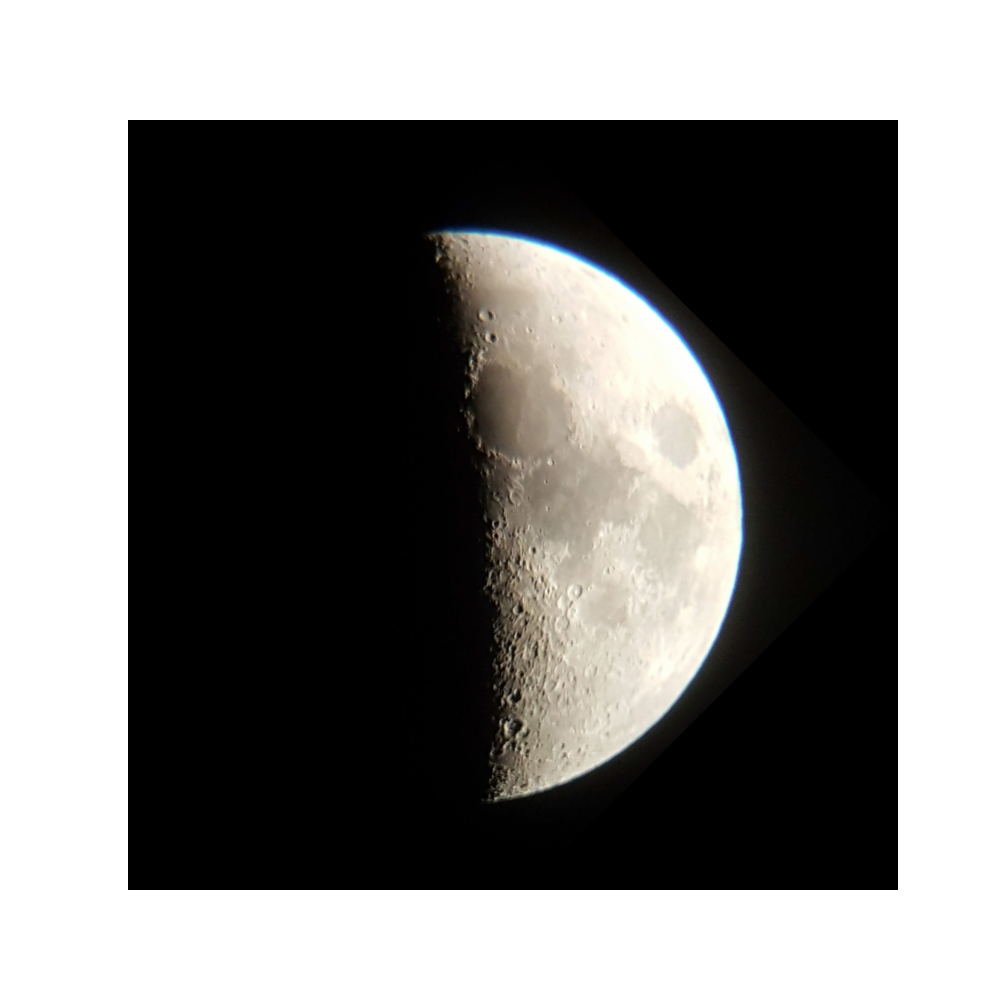

In [4]:
# run me
# Make a nice big figure
fig, ax = plt.subplots(figsize=(10,10))
ax.imshow(moon_rot, aspect='equal')
ax.axis('off')
plt.show()

You should see your image of the Moon! Now you need to get the map (or maps) of the Moon for comparison from the LPI.
<div class="alert alert-block alert-success">

1) Navigate to: https://www.lpi.usra.edu/resources/mapcatalog/LMP/ and download a map. I suggest you start with the Earthside map of the Moon (this file is also stored in this directory as **lunarnear.jpg**). This map shows the side of the Moon that we see but not at high or low latitudes. If you want to identify features at high or low latitudes I suggest you also download the Polar map.

2) Identify at least 10 features in both your map and the LPI maps. You're going to annotate your image with these features.  
<strong>ax.annotate()</strong> will draw an annotation with an arrow  
<strong>ax.text()</strong> will just draw text on your image

Example code for both is shown below. I suggest for features such as mare you use <strong>ax.text()</strong> and for smaller features you use <strong>ax.annotate()</strong>. Get the pixel coordinates for a feature by hovering over the figure. The x, y location should appear in the lower right hand corner.
    
</div>

In [5]:
# Re-running this code multiple times will overplot annotations 
# run the last cell again before this one to avoid overplotting

# Example annotation make sure there is space for the arrow
ax.annotate('Manilius', xy=(1300, 1312), xycoords='data', xytext=(900,1200), textcoords='data',
            color='white', arrowprops=dict(arrowstyle='->', color='white'))
# Example text (no arrow) - here \n means new line
ax.text(1480, 1060, 'Mare \n Serenitatis', color='k', ha='center')

# Your code here:


Text(1480, 1060, 'Mare \n Serenitatis')

The figure above should now have updated with your annotations.

<div class="alert alert-block alert-success">
When you're happy with the annotated figure save it:</div>

In [6]:
fig.savefig('./images/mymoonAnnotated.png', dpi=200, bbox_inches='tight')

# Crater Width <a class="anchor" id="CWID"></a>

Great! But there must be more data we can extract from our image right?

We can use information about our telescope and camera to work out the size of the features you labelled. Do do this we need to know a few things:

 - The size of the pixels on our camera in microns
 - The focal length of our telescope in mm
 
You'll have to look up both these values online, perhaps google: Camera/Phone Model **Sensor** and then google the sensor. If you can't find it at all then a good approximation might be $1.3\mu m$. If you used a Canon, Nikon, or professional CCD you can go to https://astronomy.tools/calculators/ccd_suitability and enter your camera there and it will display the pixel size for you.
From these two pieces of information we can calculate the resolution of our camera:

$$Resolution\ [arc\ seconds\ per\ pixel] = \frac{Pixel\ size\ [\mu m]}{Focal\ length\ [mm]}\times206.265$$
<div class="alert alert-block alert-success">
Use this formula to calculate the resolution of our camera:</div>

In [7]:
# Your code here:
pixelSize = 1.12 # micro m
fLength = 1300 # mm
const = 206.265
# If you used a smartphone multiply your resolution by the focal length of your smartphone camera
fLengthSmartphone = 4.3 # mm - found online!

res = pixelSize/fLength*const*fLengthSmartphone
res

0.7641324923076923

Now you have the resolution of your camera and telescope setup we can calculate the diameter of a crater.

<div class="alert alert-block alert-success">Locate a crater near the terminus of the Moon and measure the width in pixels of the crater by hovering over the image:</div>

In [8]:
# Your code here:
dx = 1062-1000
dx

62

We can use trigonometry to calculate the width of the crater. The angle, ```theta```, in our triangle is the width in pixels of the crater, ```dx```, times our resolution, ```res```, then converted to radians. The adjacent side is the distance to that lunar feature from Earth, ```dist```. The opposite is then the width of the crater. Using our trig functions we find ```width = np.tan(theta)*dist```.

Take a moment to draw this triangle out and make sure you understand what it represents.

We can either use the average distance to the moon for the ```dist``` or better yet we can use a package called **SkyField** which will claculate the distance to that lunar feature.

<div class="alert alert-block alert-success">Adapt the SkyField code below to calculate the distance to the lunar crater you want to measure the height of:</div>

In [9]:
# Your code here:
ts = load.timescale(builtin=True)
# Change this to the time of your observation - year, month, day, hour, min
t = ts.utc(2019, 12, 3, 17, 32)

eph = load('de421.bsp')
earth, moonSky = eph['earth'], eph['moon']

pc = PlanetaryConstants()
pc.read_text(load('moon_080317.tf'))
pc.read_text(load('pck00008.tpc'))
pc.read_binary(load('moon_pa_de421_1900-2050.bpc'))

frame = pc.build_frame_named('MOON_ME_DE421')
# Change the name of the next variable to the name of the crater you chose
# look up its latitude and longitude and enter them on the line below
# remember South lats and W longs are entered as negative numbers
theophilus = moonSky + pc.build_latlon_degrees(frame, 26.4, -11.4)

# Change the crater name in the next line
apparent = earth.at(t).observe(theophilus).apparent()
ra, dec, distance = apparent.radec(epoch='date')
distance

<Distance 0.00268411 au>

We have the distance to our feature! <div class="alert alert-block alert-success">Let's convert it to km:</div>

In [10]:
dist = distance.km
dist

401537.84176073805

<div class="alert alert-block alert-success">Now calculate the width of the crater:</div>

In [11]:
# Your code here:
theta = res*dx*np.pi/(180*3600) # *np.pi/(180*3600) converts arcseconds to radians
width = np.tan(theta)*dist
# Change the longitude in the correction to the longitude of your crater (ignore minus signs)
correction = np.cos(11.4*(np.pi/180))
width = width/correction
print(f"Crater width = {width:.2f} km")

Crater width = 94.08 km


<div class="alert alert-block alert-info">Does this value match up with the accepted value online? If not why? You should have gotten pretty close.</div>

You'll notice I added a correction term based on the crater's longitude. This takes into account the fact that we are seeing the crater at an angle and not face on unless it lies exactly at a longitude of zero.

<div class="alert alert-block alert-success">
Be sure to add this value to your annotations (don't re-save your figure yet we'll do that later).</div>

In [12]:
text1 = f"Theophilus\nMy width = {int(width)} km \nActual width = 100 km"
ax.annotate(text1, xy=(1614, 1725), xycoords='data', xytext=(760,1680), textcoords='data',
            color='white', arrowprops=dict(arrowstyle='->', color='white'), ha='center')

Text(760, 1680, 'Theophilus\nMy width = 94 km \nActual width = 100 km')

# Crater Depth <a class="anchor" id="CDEP"></a>

Now you need to choose another crater close to the terminus where you can clearly see a shadow in the crater. We are going to use the shadow to calculate the depth of the crater. First let's calculate the width of the crater like before.

<div class="alert alert-block alert-success">
    
1) Choose another crater
2) Calculate its width using the cell below
    
</div>

In [13]:
# Your code here:
dx2 = 1452-1412

# Change the name of the next variable to the name of the crater you chose
# look up its latitude and longitude and enter them on the line below
# remember South lats and W longs are entered as negative numbers
abulfeda = moonSky + pc.build_latlon_degrees(frame, -13.8, 13.9)

# Change the crater name in the next line
apparent2 = earth.at(t).observe(abulfeda).apparent()
ra2, dec2, distance2 = apparent2.radec(epoch='date')

dist2 = distance2.km

theta2 = res*dx2*np.pi/(180*3600) # *np.pi/(180*3600) converts arcseconds to radians
width2 = np.tan(theta2)*dist2
# Change the longitude in the correction to the longitude of your crater (ignore minus signs)
correction2 = np.cos(13.9*(np.pi/180))
width2 = width2/correction2
width2
print(f"Crater width = {width2:.2f} km")

Crater width = 61.29 km


So we have our width like before but how do we calculate the depth?

Look at this figure from the University of Iowa (found [here](http://astro.physics.uiowa.edu/ITU/labs/observational-labs/studying-the-moon/measure-the-height-of-lunar/)):

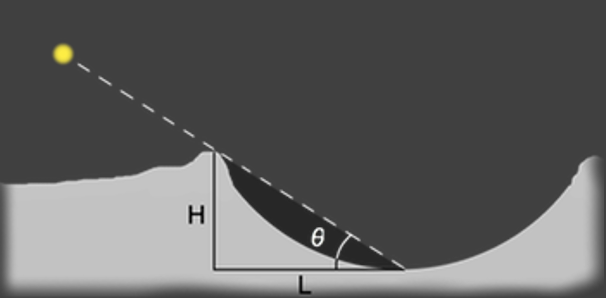

In [14]:
# run me
Image('./figures/lunarcrater_med.png')

Pause and come up with the trig relationship between $H$, $L$, and $\theta$.

Now look at this second figure also from the University of Iowa:

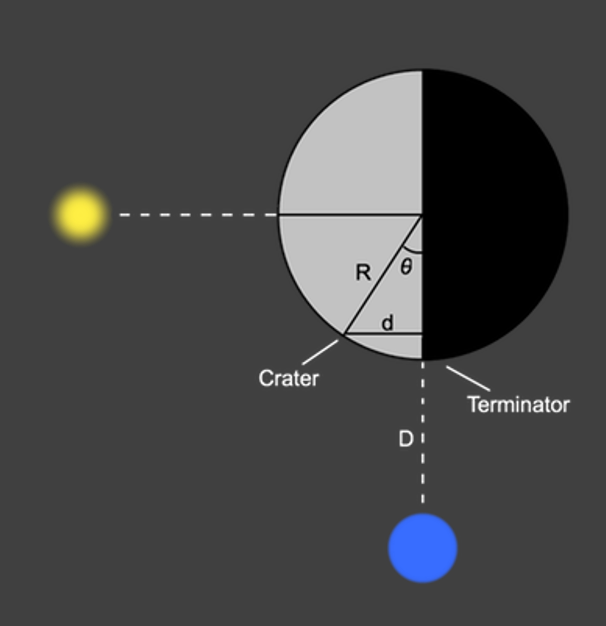

In [15]:
# run me
Image('./figures/earthmoonsuntri_med.png')

It shows the sun illuminating a portion of the Moon and our view from Earth. Here $R$ is the radius of the Moon and $d$ is the distance from the terminator to the crater. Take a moment to get a trig relationship between $R$, $d$, and $\theta$.

If we use the small angle approximation:

$$tan\theta = sin\theta = \theta$$

which holds for angles less than $\approx 10\ \deg$ we can combine these two trig identities to get the formula for the height of the crater:

$$H\approxeq L\times\frac{d}{R}$$

- For $R$ the radius of the Moon we will use $R = 1737.1\ km$
- $d$ is the distance from the terminator to the crater centre
- $L$ is the width of the shadow cast by the craters edge

<div class="alert alert-block alert-info">
Pause here and ensure you followed the math. Try to get a formula for theta from both images and equate them.</div>

<div class="alert alert-block alert-success">
To calculate $L$ work out the:
    
1) width in pixels of the crater shadow by hovering over the image, this is <strong>dxShadow</strong>
2) Divide that by the width in pixels of the crater, <strong>dx2</strong>. This gives you the fraction of the total width of the crater in km that the shadow covers
3) Times this ratio by the whole width of the crater in $km$
    
</div>

In [16]:
# Your code here:
dxShadow = 1452-1434
ratio = dxShadow/dx2
L = width2*ratio
print(f"L, Crater Shadow Width = {L:.2f} km")

L, Crater Shadow Width = 27.58 km


<div class="alert alert-block alert-success">Now measure $d$ in pixels from your image. Remember $d$ is the distance from the terminator to the center of the crater.</div>

In [17]:
# Your code here:
d = 1434-1342
d

92

<div class="alert alert-block alert-success">Convert this $d$ into an angle using the resolution from earlier and then turn that angle into a distance:</div>

In [18]:
# Your code here:
theta_d = res*d*np.pi/(180*3600)
d_km = dist2*np.sin(theta_d)

<div class="alert alert-block alert-success">All that's left is to calculate $H$:</div>

In [19]:
# Your code here:
H = L*d_km/1737.1
print(f"The crater height H = {H:.2f} km")

The crater height H = 2.17 km


<div class="alert alert-block alert-info">How does your value compare to the actual value?</div>

In our code we just used dx values for widths assuming we rotated our image perfectly at the start. To get more accurate distances we should have calculated the distance between two x, y points using trig. If you have time go back and make these changes. How do your values change?
<div class="alert alert-block alert-success">
Let's now add this new crater info onto your image and save it one last time:</div>

In [20]:
text2 = f'Abulfeda\nMy width = {int(width2)} km\nActual width = 62 km\nMy depth = {H:.1f} km\nActual depth = 3.1 km'
ax.annotate(text2, xy=(1410, 1796), xycoords='data', xytext=(770, 2170), textcoords='data',
            color='white', arrowprops=dict(arrowstyle='->', color='white'), ha='center')

Text(770, 2170, 'Abulfeda\nMy width = 61 km\nActual width = 62 km\nMy depth = 2.2 km\nActual depth = 3.1 km')

<div class="alert alert-block alert-success">
    Let's add a simple title and save the figure for the last time:
</iv>

In [21]:
ax.text(1330, 188, 'Dimitrios Moon Obs\n2019-12-03 17:32', color='w', ha='center')
fig.savefig('./images/mymoonAnnotated.png', dpi=200, bbox_inches='tight')

# LRO and LOLA <a class="anchor" id="LRO"></a>

When you've been looking up some of the features/craters for your image you will have noticed some very nice pictures. Some of these are from the Lunar Reconnaissance Orbiter ([LRO](http://lroc.sese.asu.edu/)) and the Lunar Orbiter Laser Altimeter ([LOLA](https://lola.gsfc.nasa.gov/)).

<div class="alert alert-block alert-success">
    
1) Explore the LRO site for images of features you labelled to compare to your image. I suggest you start by heading to their Archive tab then the Lunaserv Global Explorer which will let you explore all of the Moons surface. Zoom in and take some screenshots of the features you labelled. You can also explore LRO data using the JMARS tool [here](https://jmars.mars.asu.edu/).

2) When you've found an image or screenshotted one of a crater you previously labelled upload it as a jpeg to Jupyter (File - Open will take you to the dashboard then use the Upload button). We're going to plot this image next to an enlarged section of your image centered on that crater: 

</div>

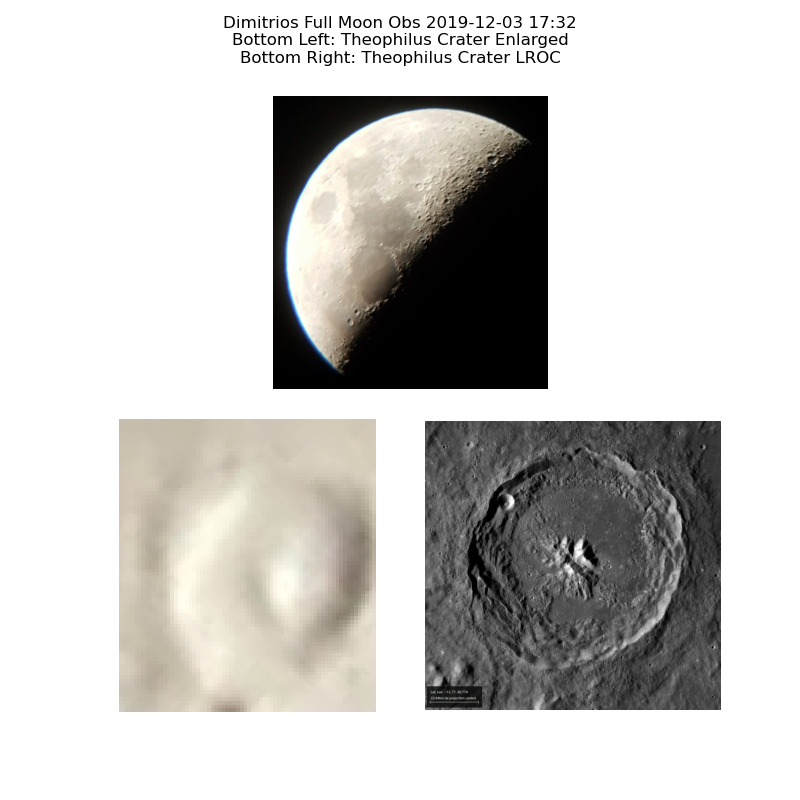

In [22]:
fig2 = plt.figure(num=2, figsize=(8,8))
ax1 = plt.subplot2grid((2,2), (0,0), rowspan=1, colspan=2)
ax2 = plt.subplot2grid((2,2), (1,0), rowspan=1)
ax3 = plt.subplot2grid((2,2), (1,1), rowspan=1)
ax1.axis('off')
ax2.axis('off')
ax3.axis('off')

# The top of this graph will show our moon image unrotated
ax1.imshow(moon, aspect='equal')

# The next image we will crop our image to 'zoom into' the crater
# run the code with these lines commented and hover over the top image to get the x, y points
# enter the numbers in the line below, ymin:ymax, xmin,xmax
moon_rot_crop = moon_rot[1690:1770, 1600:1670, :]
# If you need to rotate your image so it lines up with the LRO image
# moon_rot_crop = ndimage.rotate(moon_cropped, 190)
ax2.imshow(moon_rot_crop, aspect='equal')

# Load and plot the LRO image you downloaded/screenshotted in the bottom right
lro = io.imread('./figures/theophilusLROC.jpg')
ax3.imshow(lro, aspect='equal')

# Change the title!
Title = 'Dimitrios Full Moon Obs 2019-12-03 17:32\nBottom Left: Theophilus Crater Enlarged\nBottom Right: Theophilus Crater LROC'
plt.suptitle(Title)
plt.subplots_adjust(wspace=0.1, hspace=0.1)
plt.show()

<div class="alert alert-block alert-success">When you're happy with this figure save it:</div>

In [23]:
fig2.savefig('./images/theophilusCraterComparison.png', dpi=200)

Where does LOLA fit in you ask? LOLA measures the height of the lunar surface using lasers. You can see the products of the LOLA satellite on their website. The data from LOLA is used to make digital elevation models (DEM) of the lunar surface at a very high resolution.

I have included some LOLA data for you to look at if you want. The LOLA DEM is stored [here](https://drive.google.com/drive/folders/1kXCnfm2d2YGzs8HBQrQYu388HK6nvkzc?usp=sharing) as an IMG file. If you want to explore this data download it now. Open it up with a text editor to examine the header. It has lots of useful information like the resolution.

The program Generic Mapping Tools ([GMT](https://www.generic-mapping-tools.org/)) can be used to convert this IMG data file to a standard image format for viewing.

<div class="alert alert-block alert-warning">
    The next code cell relies on the program <strong>GMT</strong> which you must have installed separately. If you do not have <strong>GMT</strong> installed skip the next cell.
</div>

In [ ]:
# the ! infront of the command lets Jupyter know we want to run this in the command line
!gmt xyz2grd -ZTLf LDEM_16_FLOAT.IMG -GLDEM_16_FLOAT.GRD -R0/360/-90/90 -I0.0625 -r

Now let's load the result:

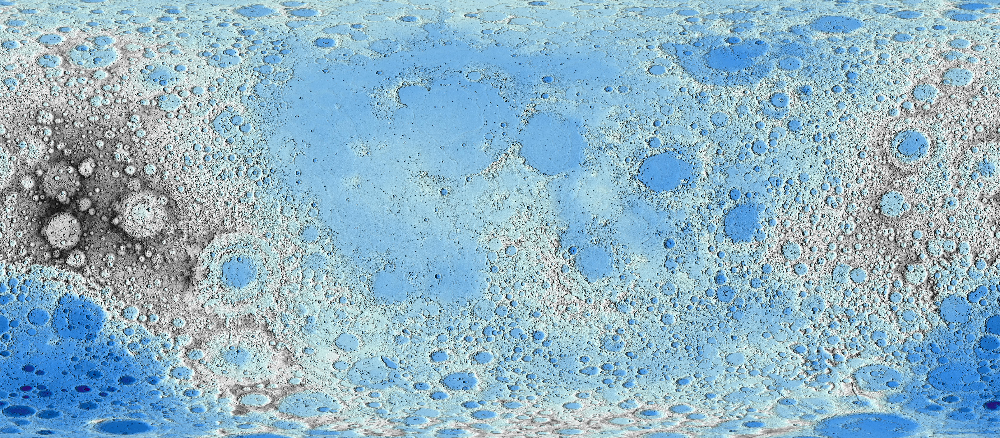

In [24]:
# run me even if you don't have gmt
Image('./figures/Lunar_LROC_WAC_GLD100_ClrShade_79s79n_9216.jpg')

Wow! This is a cylindrical projection of the entire lunar surface with blue areas lower than black (high) areas.

If you want to look at more of the data products from both LRO and LOLA head on over to the Lunar Orbiter section of the [PDS Geoscience Node](https://ode.rsl.wustl.edu/moon/index.aspx) at Washington University.

I have included some raw LOLA data as csv's for you to have a play with in pandas and matplotlib in the subdirectory **./catalan/RDR_272E273E_46p130529S45SPointPerRow_csv_table** (now stored on Google Drive [here](https://drive.google.com/drive/folders/1kXCnfm2d2YGzs8HBQrQYu388HK6nvkzc?usp=sharing)). This data is centered on the Catalan crater. Each .csv file has an associated .lbl file with information about the .csv file (like a header).

This animation of the Catalan crater was made with the **RDR_272E273E_46p130529S45STopoFull_csv_table.csv** file and matplotlib's 3D plotting functionality (the code is stored in **./catalan/catalan.py**).

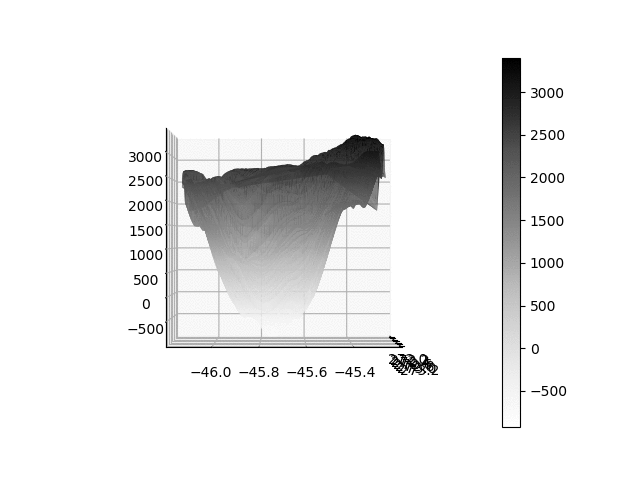

In [25]:
# run me
Image('./catalan/catalan.gif')

# Challenge <a class="anchor" id="Challenges"></a>

1) Change the code we used to calculate width and depths of craters to use x,y points to calculate crater widths in pixels as described above  
2) Have a go at processing the included LOLA data on the Catalan crater  
3) Change the code to use the method described in the University of Exeter reference to calculate depths which doesn't rely on the small angle approximation  

Here is a code snippet you could add after the first calls to SkyField to get the [sub Earth](https://rhodesmill.org/skyfield/planetary.html#computing-lunar-libration) and sub Solar points on the moon for the Exeter method. I have added an ***exeter.py*** file with this code snippet and the lines after which calculate the height with this method (you get more accurate heights!).

```
sun = eph['sun']

p = (earth - moonSky).at(t)
latSubE, lonSubE, distanceSubE = p.frame_latlon(frame)
lonSubE_degrees = (lonSubE.degrees - 180.0) % 360.0 - 180.0
print('sub-Earth point latitude: {:.3f}'.format(latSubE.degrees))
print('sub-Earth point longitude: {:.3f}'.format(lonSubE_degrees))

p2 = (sun - moonSky).at(t)
latSubS, lonSubS, distanceSubS = p2.frame_latlon(frame)
lonSubS_degrees = (lonSubS.degrees - 180.0) % 360.0 - 180.0
print('sub-Solar point latitude: {:.3f}'.format(latSubS.degrees))
print('sub-Solar point longitude: {:.3f}'.format(lonSubS_degrees))
```

4) HARD - Have a go at looking at or processing LRO/LOLA data with GMT and the PDS Geoscience Node

# References <a class="anchor" id="References"></a>

Resolution of ccd/telescope, Astronomy Tools, https://astronomy.tools/calculators/ccd_suitability  
Depth of Craters - Univeristy of Iowa, http://astro.physics.uiowa.edu/ITU/labs/observational-labs/studying-the-moon/measure-the-height-of-lunar/  
Crater Diameters - University of Exeter, http://www.astro.ex.ac.uk/obs/experiments/lunar/script.html  

Lunar Orbital Data Explorer, PDS Geosciences Node - Washington University, https://ode.rsl.wustl.edu/moon/index.aspx    
JMARS Tool, https://jmars.mars.asu.edu/  
Lunar Reconnaissance Orbiter, http://lroc.sese.asu.edu/  
Lunar Orbiter Laser Altimeter, https://lola.gsfc.nasa.gov/

# Acknowledgements <a class="anchor" id="ACK"></a>

Thanks to [Dr. John Keller](https://science.gsfc.nasa.gov/sed/bio/john.w.keller) for his guidance towards the GMT tool and processing of LOLA .IMG data files.

Thanks also to Brandon Rhodes author of the [SkyField](https://rhodesmill.org/skyfield/) package for advice on calculating sub-Earth and sub-Solar points on the Moon.

## Sharing

If you share, use or modify this activity in any way use the citation in this [txt file](https://github.com/astroDimitrios/Astronomy/blob/master/CITATION.txt).    
Please contact me at astrodimitrios@gmail.com with any suggestions, mistakes found, or general questions about teaching astronomy with Python.

© Dimitrios Theodorakis GNU General Public License v3.0 


https://github.com/astroDimitrios/Astronomy  